In [1]:
import numpy as np
import matplotlib.pyplot as plt
import json
import os
import pickle
import pandas as pd
import sys
import argparse
import gc
import pandas as pd
import plotly.express as px
import numpy as np
from sklearn.decomposition import PCA
import plotly.graph_objects as go

sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '..')))
sys.path.insert(0, os.path.abspath(os.path.join(os.getcwd(), '..')))

from blind_localization.visualize import visualize_session_metrics

/home/th3129/.local/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### 0. Helper Function

In [2]:
def read_pickle(file_path):
    with open(file_path, 'rb') as f:
        data = pickle.load(f)
    return data

In [3]:
walk_dir = '/scratch/th3129/region_decoding/results/Neuronexus/spectrogram_preprocessed/wave2vec2/across_session/'

In [4]:
class PCAVisualizer:
    def __init__(self, label_json, output_path):
        self.output_path = output_path
        self.label_json = label_json

    def create_pca(self, embeddings, labels, n_components, session, stage):
        if len(str(labels[0])) == 1:
            labels = [self.label_json[str(label)] for label in labels]
        pca = PCA(n_components=n_components)
        reduced_embeddings = pca.fit_transform(embeddings)

        df = pd.DataFrame(reduced_embeddings, columns=[f"PC{i+1}" for i in range(n_components)])
        df["Label"] = labels
        color_map = {"Cortex": "#f0553b", "CA1": "#ffa15a", "CA2": "#636efa", "CA3": "#00cc96", "DG":"#ab63fa", "SWR": "#f0553b", "NN": "#636efa"}

        unique_labels = df["Label"].astype(str).unique()
        full_color_map = {
            label: next((color for key, color in color_map.items() if key.lower() in label.lower()), "#999999")
            for label in unique_labels
        }

        if n_components == 2:
            fig = px.scatter(
                df,
                x="PC1",
                y="PC2",
                color="Label",
                color_discrete_map=full_color_map,
                title=f"2D PCA of {stage} Embeddings (Session: {session})",
                labels={"Label": "Class Label"}
            )
        elif n_components == 3:
            fig = px.scatter_3d(
                df,
                x="PC1",
                y="PC2",
                z="PC3",
                color="Label",
                color_discrete_map=full_color_map,
                title=f"3D PCA of {stage} Embeddings (Session: {session})",
                labels={"Label": "Class Label"},
            )
        else:
            raise ValueError("n_components must be 2 or 3 for visualization.")
        fig.update_layout(
            width=1000,
            height=800,
            paper_bgcolor='white',
            plot_bgcolor='white'
        )
        fig.show()

    def create_combined_pca(self, datasets, n_components, session, title="combined"):
        combined_embeddings = []
        combined_labels = []
        for stage, data in datasets.items():
            combined_embeddings.append(data["embeddings"])
            if title == "combined":
                combined_labels.extend([f"{stage}_{self.label_json[str(label)[-1]]}"
                                        for label in data["labels"]])
            else:
                combined_labels.extend([f"{stage}_{label}" for label in data["labels"]])

        combined_embeddings = np.vstack(combined_embeddings)

        self.create_pca(combined_embeddings, combined_labels, n_components, session, title)


### 1. Frequency Band Experiment

In [58]:
freq_bands = {'delta': [0.5, 4], 'theta': [4, 8], 'alpha': [8, 12], 'beta': [13, 30], 'gamma': [30, 100]}
freq_band_acc = {}

for root, dirs, files in os.walk(walk_dir):
    for file in files:
        current_session = file.replace('_results.pickle', '')
        
        if file.endswith('_results.pickle') and any(freq in current_session for freq in freq_bands.keys()):            
            saved_data = read_pickle(walk_dir + file)
            band = current_session.split('_')[-1]
            freq_band_acc[band] = saved_data["test_acc"]

        if file.endswith('_results.pickle') and current_session == 'NN_syn_01':
            saved_data = read_pickle(walk_dir + file)
            freq_band_acc['broadband'] = saved_data["test_acc"]

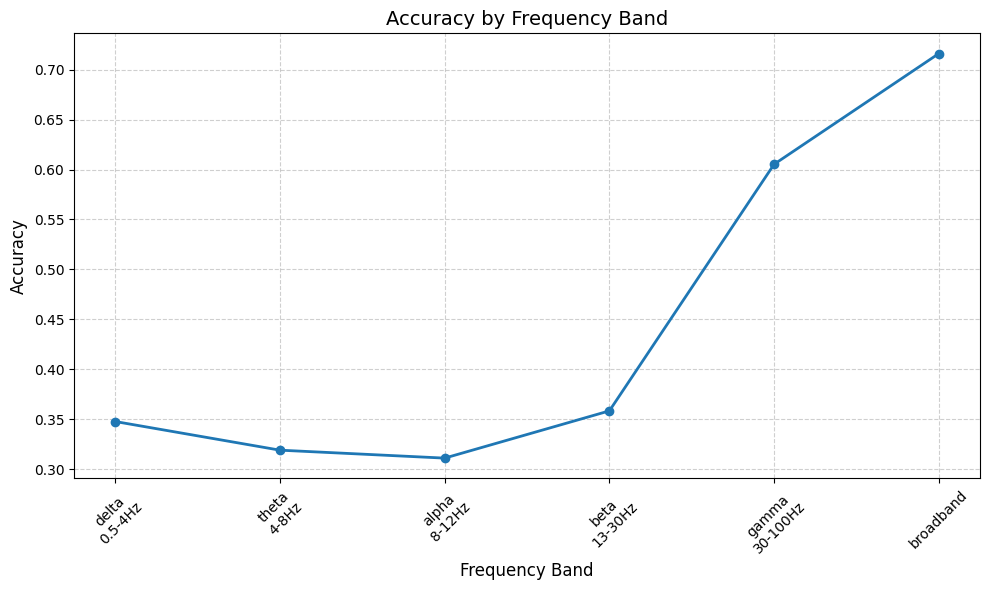

In [59]:
freq_bands_keys = [f'{k}\n{v[0]}-{v[1]}Hz' for k, v in freq_bands.items()] + ['broadband']
sorted_keys = list(freq_bands.keys()) + ['broadband']
sorted_values = [freq_band_acc[k] for k in sorted_keys]

plt.figure(figsize=(10, 6))
plt.plot(freq_bands_keys, sorted_values, marker='o', linestyle='-', linewidth=2)

plt.xlabel('Frequency Band', fontsize=12)
plt.ylabel('Accuracy', fontsize=12)
plt.title('Accuracy by Frequency Band', fontsize=14)

plt.grid(True, linestyle='--', alpha=0.6)
plt.xticks(rotation=45, fontsize=10)
plt.yticks(fontsize=10)

plt.tight_layout()
plt.show()

In [9]:
freq_band_raw_signal = {}

for root, dirs, files in os.walk(walk_dir):
    for file in files:
        current_session = file.replace('_dataset_dict.pickle', '')
        
        if file.endswith('_dataset_dict.pickle') and any(freq in current_session for freq in freq_bands.keys()):
            print("Reading "+file)
            
            saved_data = read_pickle(walk_dir + file)
            band = current_session.split('_')[-1]
            freq_band_raw_signal[band] = saved_data["test"]["input_values"][0]
            
            del saved_data
            gc.collect()

Reading NN_syn_01_delta_dataset_dict.pickle
Reading NN_syn_01_gamma_dataset_dict.pickle
Reading NN_syn_01_beta_dataset_dict.pickle
Reading NN_syn_01_alpha_dataset_dict.pickle
Reading NN_syn_01_theta_dataset_dict.pickle


In [11]:
filename = '../results/freq_band_signal.pkl'
with open(filename, 'wb') as file:
    pickle.dump(freq_band_raw_signal, file)

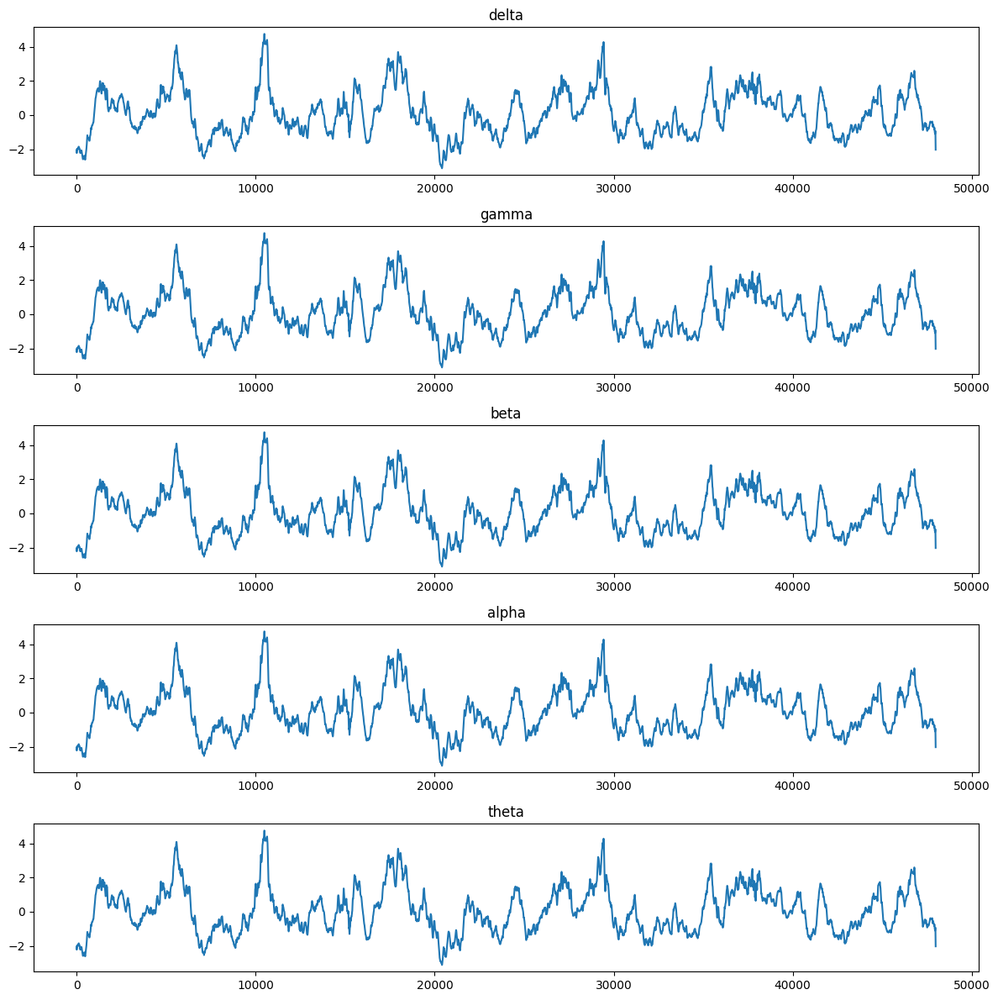

In [23]:
cnt = 1
plt.figure(figsize=(12, 12))
for key in freq_band_raw_signal.keys():
    plt.subplot(5, 1, cnt)
    plt.plot(freq_band_raw_signal[key])
    plt.title(key)
    cnt += 1
plt.tight_layout()
plt.show()

### 2. SWR Prediction

In [5]:
def text_to_idx(trial_chans):
    trials = []
    channels = []
    for i, trial_chan in enumerate(trial_chans):
        #separate by "_", last 1 is channel index, last 2 is trial index
        trial_idx = int(trial_chan.split("_")[-2])
        channel_idx = int(trial_chan.split("_")[-1])
        trials.append(trial_idx)
        channels.append(channel_idx)
    return trials, channels

In [9]:
def load_results(pickle_path, session):
    results = pickle.load(open(f"{pickle_path}/{session}_results.pickle", "rb"))
    trial_chans = results['test_trial_chans']
    trials, channels = {}, {}
    
    trials['train'], channels['train'] = text_to_idx(results['train_trial_chans'])
    trials['val'], channels['val'] = text_to_idx(results['val_trial_chans'])
    trials['test'], channels['test'] = text_to_idx(results['test_trial_chans'])

    # reorder trial_chans to separate trial indices and channel indices
    logits = results['test_logits']
    labels = results['test_labels']
    acc = results['test_acc']
    print(len(trials['test']), len(channels['test']), len(logits), len(labels))

    assert len(trials['test']) == len(channels['test']) == len(logits) == len(labels)
    return logits, labels, trials, channels, acc

In [7]:
sessions = ["AD_HF01_1", "AD_HF02_2", "AD_HF02_4", "AD_HF03_1", "AD_HF03_2", "NN_syn_01", "NN_syn_02"]

for root, dirs, files in os.walk(walk_dir):
    for file in files:
        current_session = file.replace('_results.pickle', '')
        
        if file.endswith('_results.pickle') and any(session==current_session for session in sessions):
            saved_data = read_pickle(walk_dir + file)
            test_embeddings = saved_data['test_embeddings']
            print(current_session, np.array(test_embeddings).shape)

AD_HF03_2 (156, 256)
NN_syn_01 (666, 256)
AD_HF01_1 (776, 256)
AD_HF02_2 (618, 256)
NN_syn_02 (663, 256)
AD_HF02_4 (567, 256)
AD_HF03_1 (406, 256)


In [ ]:
pickle_path = f'/scratch/th3129/region_decoding/results/Neuronexus/spectrogram_preprocessed/wave2vec2/across_session/'
session = 'NN_syn_01'

logits, labels, trials, channels, acc = load_results(pickle_path, session)
results = pickle.load(open(f"{pickle_path}/{session}_results.pickle", "rb"))

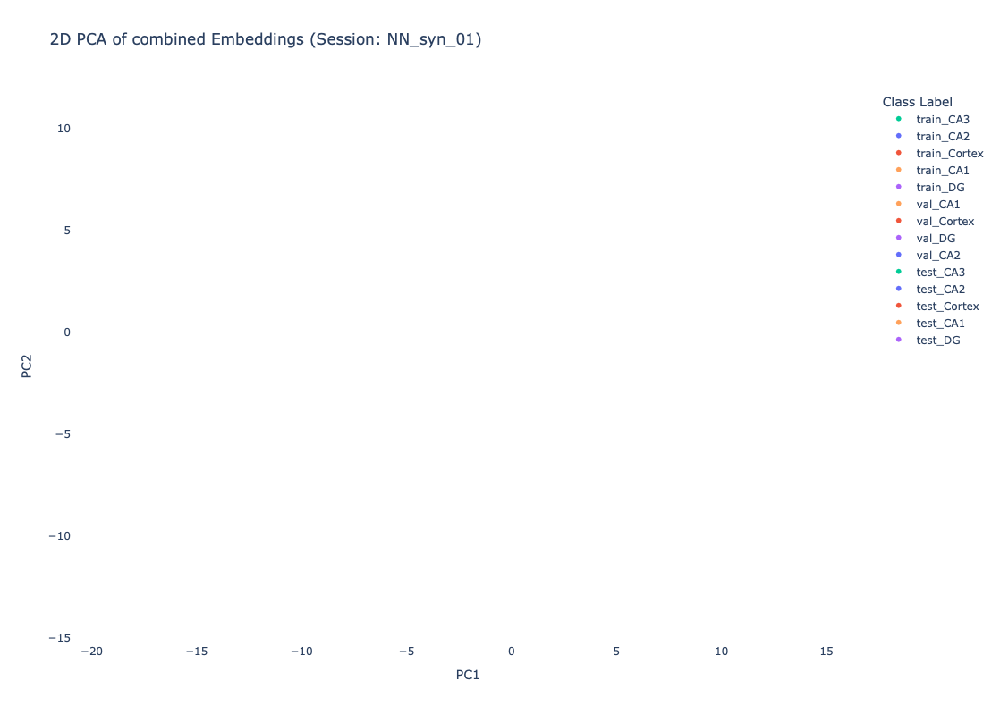

In [9]:
label_json = {'0': 'Cortex', '1': 'CA1', '2': 'CA2', '3': 'CA3', '4': 'DG'}

visualizer = PCAVisualizer(label_json, output_path=None)
datasets = {
    "train": {"embeddings": results['train_embeddings'], "labels": results['train_labels']},
    "val": {"embeddings": results['val_embeddings'], "labels": results['val_labels']},
    "test": {"embeddings": results['test_embeddings'], "labels": results['test_labels']}
}
visualizer.create_combined_pca(datasets, 2, session, "combined")

In [58]:
from scipy.io import loadmat
import json

session_idx = 6
session = sessions[session_idx]

json_path = '/scratch/th3129/region_decoding/script/Neuronexus_preprocessing/file_path_hpc.json'
pickle_path = '/scratch/th3129/region_decoding/results/Neuronexus/spectrogram_preprocessed/wave2vec2/across_session/'

# load labels and trial index from results pickles
logits, labels, trials, channels, acc = load_results(pickle_path, session)
results = pickle.load(open(f"{pickle_path}/{session}_results.pickle", "rb"))

# load swr timestamp from mat file
with open(json_path, "r") as f:
    session_dict = json.load(f)
    ripple_path = session_dict[session]["swr_path"]

data = loadmat(ripple_path)
ripple_events = data['ripples'][0][0][0]
event_times = ripple_events[(ripple_events[:, 0] > 2160) & (ripple_events[:, 0] < 2160+300)][:, 0]
trial_length = 3
swr_trial_numbers = np.unique((event_times - 2160) // trial_length)

In [59]:
label_json_swr = {'0': 'NN', '1': 'SWR'}

swr_labels_train = np.where((np.isin(trials['train'], swr_trial_numbers)) & (results['train_labels'] == 1), 1, 0)
swr_labels_val = np.where((np.isin(trials['val'], swr_trial_numbers)) & (results['val_labels'] == 1), 1, 0)
swr_labels_test = np.where((np.isin(trials['test'], swr_trial_numbers)) & (results['test_labels'] == 1), 1, 0)

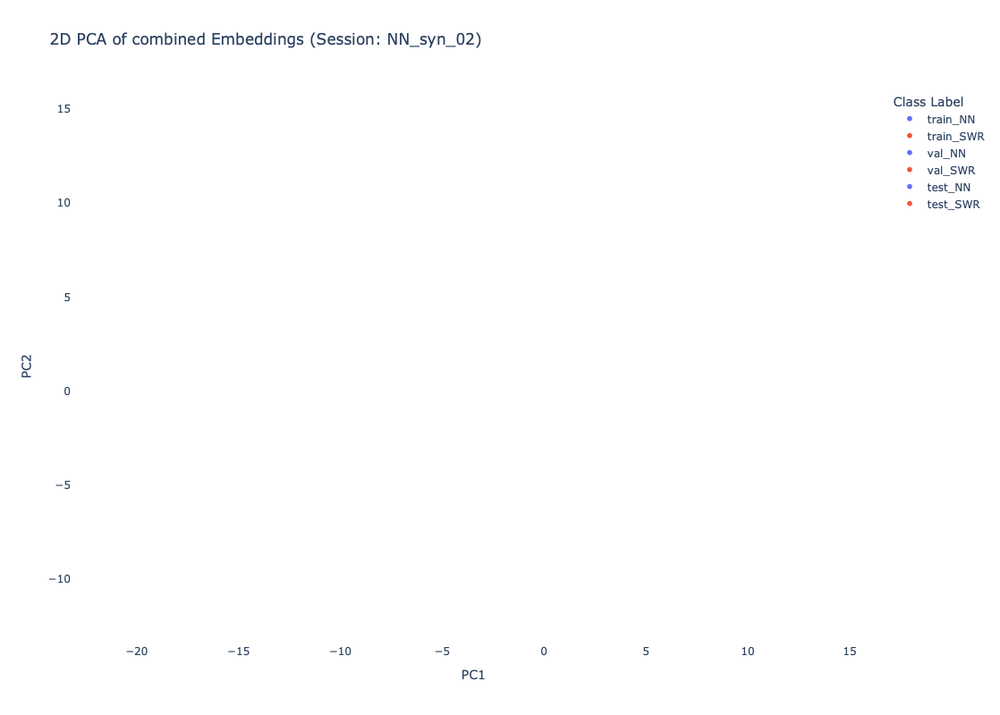

In [60]:
visualizer_swr = PCAVisualizer(label_json_swr, output_path=None)
datasets = {
    "train": {"embeddings": results['train_embeddings'], "labels": swr_labels_train},
    "val": {"embeddings": results['val_embeddings'], "labels": swr_labels_val},
    "test": {"embeddings": results['test_embeddings'], "labels": swr_labels_test}
}
visualizer_swr.create_combined_pca(datasets, 2, session, "combined")

In [18]:
X_train = datasets["train"]["embeddings"]
y_train = datasets["train"]["labels"]
X_test = datasets["test"]["embeddings"]
y_test = datasets["test"]["labels"]

In [20]:
np.array(X_train).shape

(64908, 256)

In [36]:
from sklearn.linear_model import SGDClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score
from sklearn.utils.class_weight import compute_sample_weight

clf = SGDClassifier(loss='hinge', class_weight='balanced', max_iter=1000, tol=1e-3)
# clf = MLPClassifier(hidden_layer_sizes=(64, 32), max_iter=300, random_state=42)
clf.fit(X_train, y_train)
y_pred = clf.predict(X_test)

In [37]:
acc = accuracy_score(y_test, y_pred)
print(f"Test Accuracy: {acc:.4f}")

Test Accuracy: 0.7818


In [34]:
5740/(5740+920)

0.8618618618618619

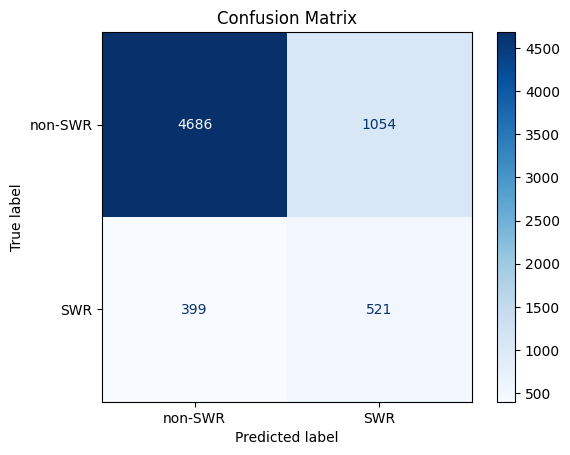

In [38]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

cm = confusion_matrix(y_test, y_pred)

disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["non-SWR", "SWR"])
disp.plot(cmap=plt.cm.Blues)
plt.title("Confusion Matrix")
plt.show()

### 3. Analyze Sharp Wave Ripple Events

In [25]:
from scipy.io import loadmat
import json

session_idx = 5
sessions = ["AD_HF01_1", "AD_HF02_2", "AD_HF02_4", "AD_HF03_1", "AD_HF03_2", "NN_syn_01", "NN_syn_02"]

session = sessions[session_idx]

json_path = '/scratch/th3129/region_decoding/script/Neuronexus_preprocessing/file_path_hpc.json'
pickle_path = '/scratch/th3129/region_decoding/data/Neuronexus/lfp'

# load swr timestamp from mat file
with open(json_path, "r") as f:
    session_dict = json.load(f)
    ripple_path = session_dict[session]["swr_path"]

data = loadmat(ripple_path)
print(ripple_path)
ripple_events = data['ripples'][0][0][0]
event_times = ripple_events[(ripple_events[:, 0] > 2160) & (ripple_events[:, 0] < 2160+300)][:, 0]
trial_length = 3
swr_trial_numbers = np.unique((event_times - 2160) // trial_length)

/scratch/th3129/shared/Neuronexus_dataset/NN_syn_20230601/NN_syn_20230601.ripples.events.mat


In [15]:
ripples = data['ripples'][0][0]['maps'][0, 0]['ripples']
print(ripples.shape)

(330, 299)


In [11]:
peaks = data['ripples'][0][0]['peaks']

In [35]:
swr_trial_numbers

array([ 0.,  1.,  7.,  8.,  9., 11., 13., 25., 31., 32., 33., 35., 48.,
       49., 54., 58., 59., 61., 62., 64., 65., 66., 74., 76., 78., 79.,
       84., 85., 87., 88., 89., 91., 93., 94., 98., 99.])

In [13]:
channel = data['ripples'][0][0]['channelInfo']['detectionChannel'][0][0][0][0]
print(channel)

471


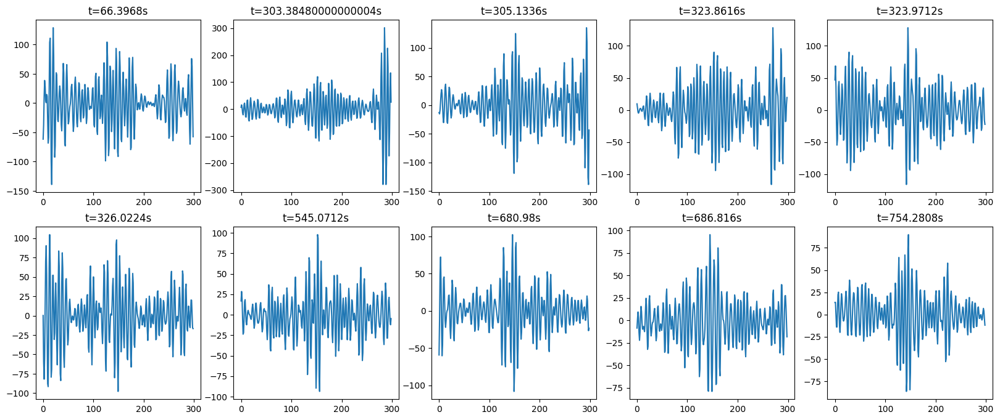

In [14]:
plt.figure(figsize=(20, 8))
for i in range(10):
    plt.subplot(2, 5, i+1)
    plt.plot(ripples[i])
    plt.title(f"t={ripple_events[i][0]}s")

In [23]:
def load_preprocessed_data(pickle_path, file_path, data_type='raw'):
    features, labels, trials, chans = {}, {}, {}, {}
    for session in file_path:
        if data_type == 'raw':
            data = pickle.load(open(f"{pickle_path}/{session}_raw.pickle", 'rb'))
        elif data_type == 'lfp':
            data = pickle.load(open(f"{pickle_path}/{session}_lfp.pickle", 'rb'))
        X, y, trial_idx, chan_id = zip(*[(d[0], d[1], d[2], d[3]) for d in data])
        X = [x if x.shape[0] == 3749 else x[:3749] for x in X]
        features[session] = np.array(X)
        labels[session] = np.array(y, dtype=int)
        trials[session] = np.array(trial_idx)
        chans[session] = np.array(chan_id)

        non_zero_indices = [i for i, x in enumerate(features[session]) if not np.all(x == 0)]

        features[session] = features[session][non_zero_indices]
        labels[session] = labels[session][non_zero_indices]
        trials[session] = trials[session][non_zero_indices]
        chans[session] = chans[session][non_zero_indices]

        # Sanity check
        assert len(features[session]) == len(labels[session]) == len(trials[session]) == len(chans[session]), \
            f"Inconsistent data sizes for session {session}"

    return features, labels, trials, chans

In [26]:
features, labels, trials, chans = load_preprocessed_data(pickle_path, [session], 'lfp')

In [30]:
features = features['NN_syn_01']
labels = labels['NN_syn_01']
trials = trials['NN_syn_01']
chans = chans['NN_syn_01']

In [39]:
selected_channels = chans[trials == 0]

In [42]:
features[trials == 0][selected_channels == 471].shape

(1, 3749)

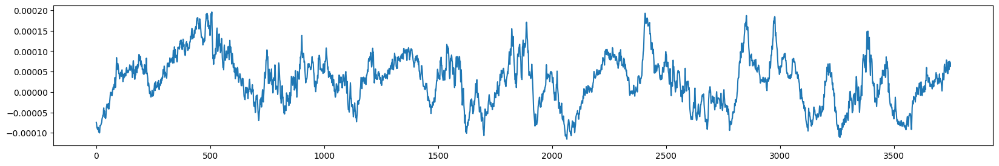

In [46]:
plt.figure(figsize=(20, 3))
plt.plot(features[trials == 0][selected_channels == 471].T)